# Neumap dataset

Este conjunto de datos difiere del resto en que procede de datos de investigadores del Centro Nacional de Investigaciones Cardiovasculares (CNIC), por lo que el trabajo realizado se basa principalmente en los resultados esperados por los investigadores. A pesar de esto, vamos a realizar los mismos análisis que en los casos anteriores:
1. **Análisis del dataset con scVelo.** Llevamos a cabo los análisis necesarios, añadiendo además nuestros propios análisis de interes.

In [4]:
import os
import re
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import igraph
import scvelo as scv
import loompy
import anndata
import numpy as np
#import velocyto as vcy

In [5]:
neutrophils_color_palette = {1: "#d163e6",2: "#008cf9",3: "#ff9287",4: "#878500",5: "#ebac23",6: "#006e00",7: "#00a76c",
                             8: "#b80058",9: "#00c6f8",10: "#5954d6",11: "#b24502",12: "#00bbad"}


In [3]:
print(os.getcwd())

/home/pbeltranl/NetVolumes/TIERRA/U_Bioinformatica/LABS/U_Bioinformatica/UNIT_MEMBERS/pbeltranl/TFM/Datasets' analysis/6. Ivan_dataset


## 1. Análisis según scVelo

In [ ]:
Vel_SeurObj_no_mutants = scv.read("./data/Vel_SeurObj_no_mutants_merged.h5ad")
Vel_SeurObj_no_mutants

In [ ]:
Vel_SeurObj_no_mutants

In [ ]:
# show proportions of spliced/unspliced 
scv.utils.show_proportions(Vel_SeurObj_no_mutants)

In [46]:
Vel_SeurObj_no_mutants.obs["integrated_snn_res.0.2"] = Vel_SeurObj_no_mutants.obs["integrated_snn_res.0.2"].astype("category")

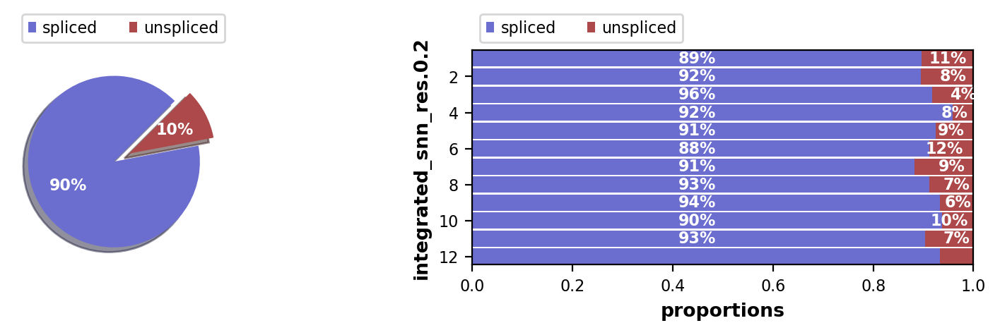

In [48]:
scv.pl.proportions(Vel_SeurObj_no_mutants, groupby="integrated_snn_res.0.2")

In [ ]:
scv.pl.proportions(Vel_SeurObj_no_mutants, groupby="")

### 1.1. Stochastic

In [7]:
neumap_stochastic = Vel_SeurObj_no_mutants.copy()

#### 1.1.1. Analysis

In [9]:
# Standard scvelo processing 
scv.pp.filter_and_normalize(neumap_stochastic, min_shared_counts=30, n_top_genes=2000)
scv.pp.moments(neumap_stochastic, n_pcs=30, n_neighbors=50)

Filtered out 21524 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
computing neighbors
    finished (0:00:52) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:16) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [10]:
scv.tl.velocity(neumap_stochastic, mode='stochastic')
scv.tl.velocity_graph(neumap_stochastic)

computing velocities
    finished (0:00:27) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/4 cores)


  0%|          | 0/109446 [00:00<?, ?cells/s]

    finished (0:11:38) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [12]:
neumap_stochastic.write_h5ad("./data/stochastic_model_neighbors_50.h5ad")

In [3]:
neumap_stochastic = scv.read("./data/stochastic_model_neighbors_50.h5ad")
neumap_stochastic

AnnData object with n_obs × n_vars = 109446 × 2000
    obs: 'CHIP', 'Cell_Index', 'Sample_Name', 'Sample_Tag', 'celltype', 'celltype_cell', 'condition', 'dataset', 'experiment', 'experiment_mine', 'integrated_snn_res.0.2', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'orig.names', 'tissue', 'batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'neighbors', 'pca', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

computing velocity embedding
    finished (0:00:45) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_stream.png


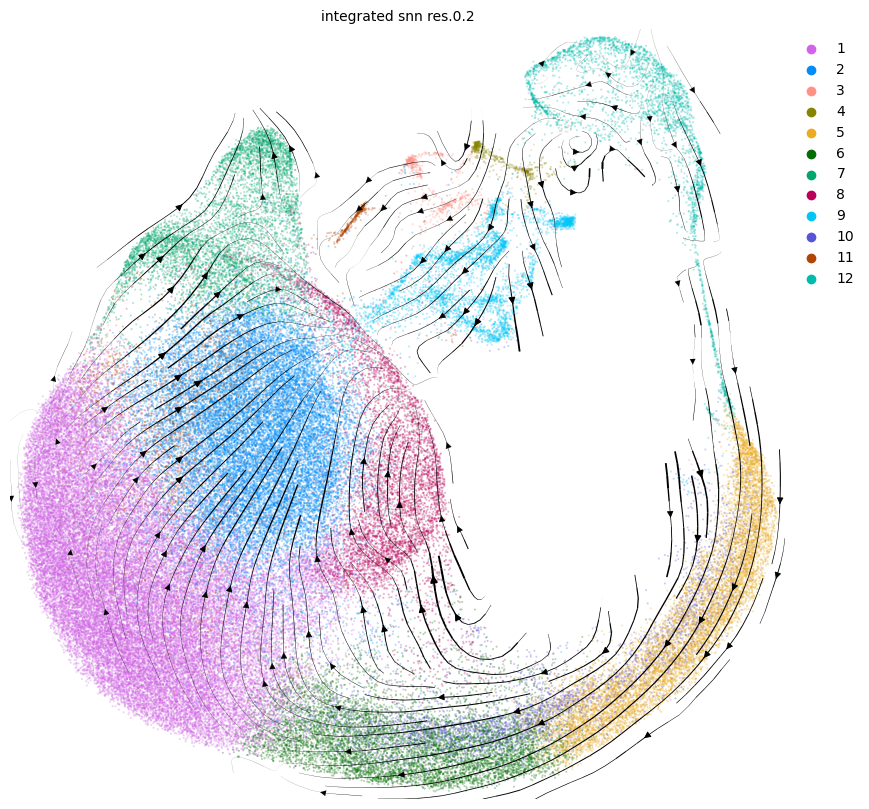

In [5]:
scv.pl.velocity_embedding_stream(neumap_stochastic, basis="umap", palette=neutrophils_color_palette, figsize=(10,10),
                                 color="integrated_snn_res.0.2",legend_loc="upper right", 
                                 save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_stream.png")

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_arrows.png


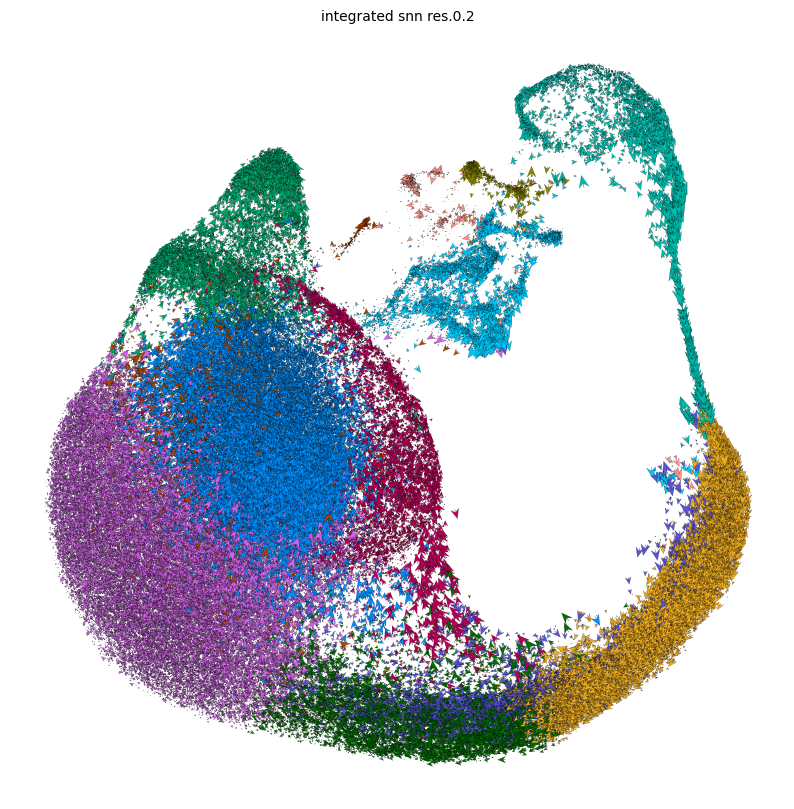

In [14]:
scv.pl.velocity_embedding(neumap_stochastic, basis="umap", arrow_length=10, arrow_size=10,
                          color="integrated_snn_res.0.2", figsize=(10,10), palette=neutrophils_color_palette,
                          save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_arrows.png")

computing velocity embedding
    finished (0:00:47) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


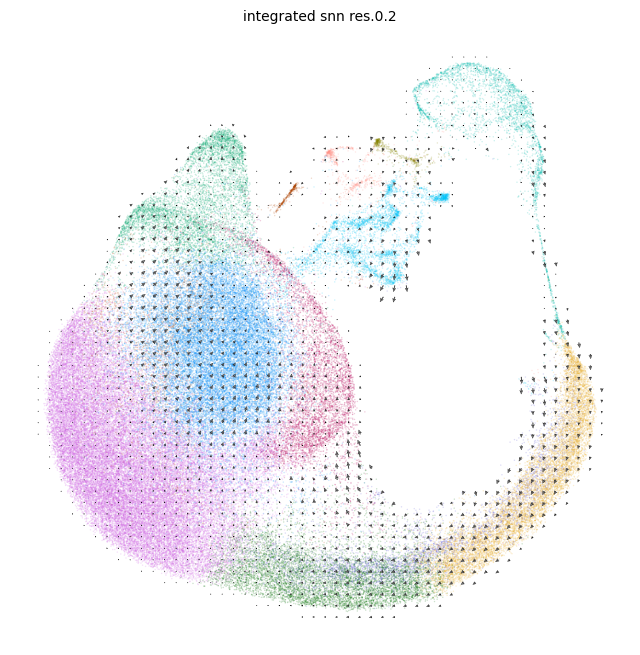

In [23]:
scv.pl.velocity_embedding_grid(neumap_stochastic, basis='umap', palette=neutrophils_color_palette, color="integrated_snn_res.0.2", figsize=(8,8))

#### 1.1.2. Velocity confidence

In [24]:
scv.tl.velocity_confidence(neumap_stochastic)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


In [25]:
np.mean(neumap_stochastic.obs["velocity_confidence"])

0.8082833491333713

In [26]:
np.median(neumap_stochastic.obs["velocity_confidence"])

0.8235118389129639

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_confidence_velocyto.png


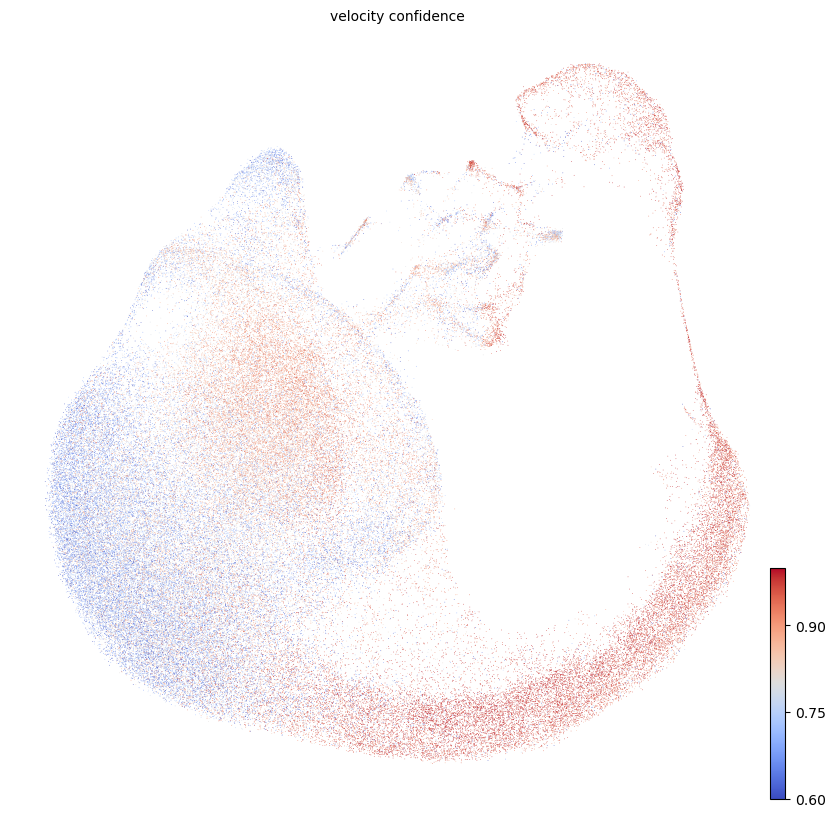

In [28]:
scv.pl.scatter(neumap_stochastic, c='velocity_confidence', cmap='coolwarm', vmin=0.6, vmax=1, figsize=(10,10),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_confidence_velocyto.png")

#### 1.1.3. Velocity pseudotime (comparable to latent time)

In [5]:
scv.tl.velocity_pseudotime(neumap_stochastic)

computing terminal states
    identified 10 regions of root cells and 1 region of end points .
    finished (0:02:10) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_pseudotime.png


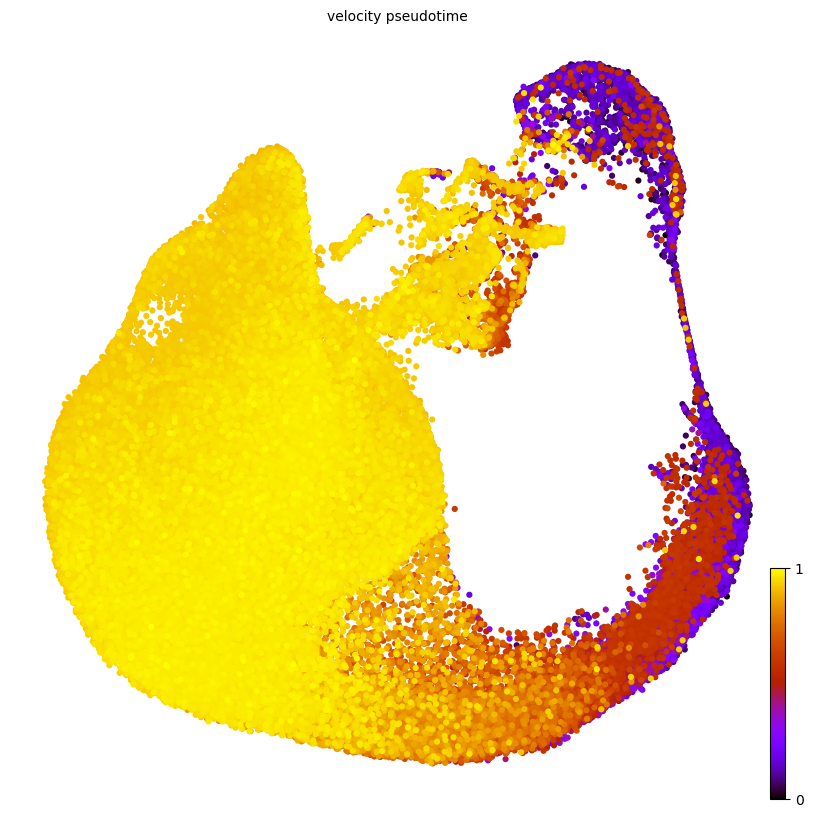

In [6]:
scv.pl.scatter(neumap_stochastic, basis="umap", color='velocity_pseudotime', cmap='gnuplot', size=80,figsize=(10,10),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_pseudotime.png")

In [7]:
scv.tl.rank_velocity_genes(neumap_stochastic, groupby='integrated_snn_res.0.2')

ranking velocity genes
    finished (0:00:54) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_pseudotime_heatmap.png


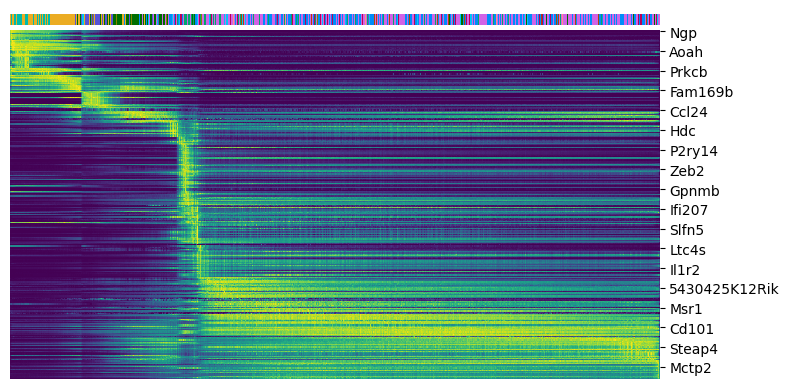

In [8]:
top_genes = neumap_stochastic.var["spearmans_score"].sort_values(ascending=False).index[:300]
scv.pl.heatmap(neumap_stochastic, var_names=top_genes, sortby='velocity_pseudotime', col_color='integrated_snn_res.0.2', n_convolve=100,
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_pseudotime_heatmap.png")

#### 1.1.4. Root cells and endpoints

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_root_end.png


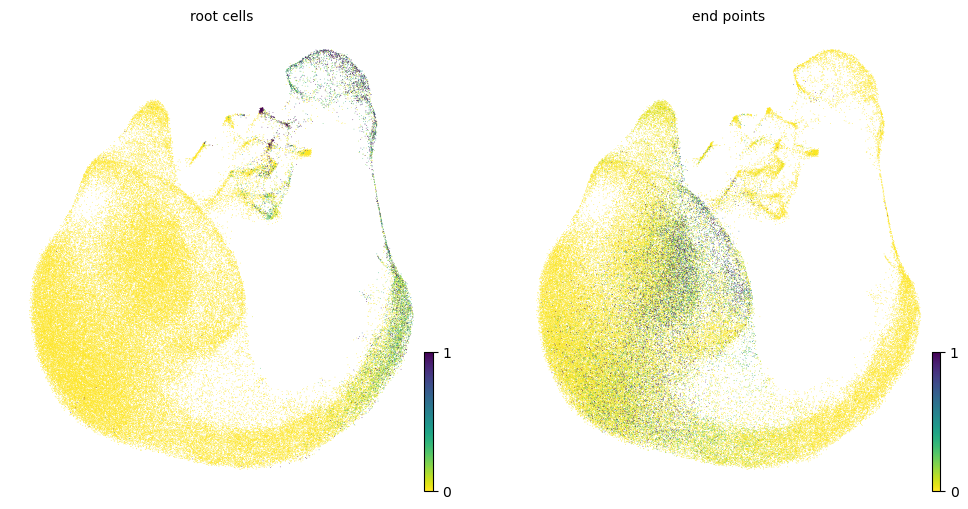

In [13]:
scv.pl.scatter(neumap_stochastic, color=['root_cells', 'end_points'], figsize=(6,6),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_stochastic_root_end.png")

#### 1.1.5. Top-spearmans_score genes

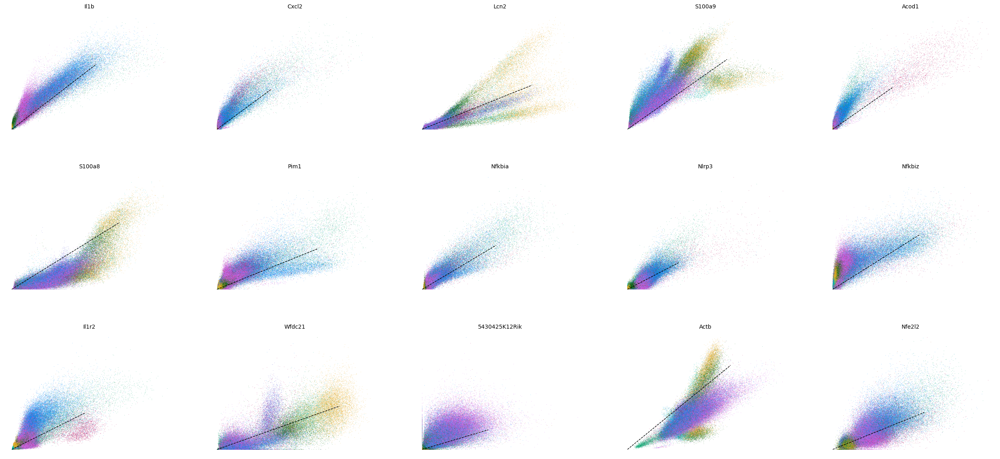

In [12]:
top_genes = neumap_stochastic.var['spearmans_score'].sort_values(ascending=False).index
scv.pl.scatter(neumap_stochastic, basis=top_genes[:15], ncols=5, frameon=False, color="integrated_snn_res.0.2")

#### 1.1.6. Cluster-specific top-spearmans_score genes

In [11]:
df = scv.get_df(neumap_stochastic, 'rank_velocity_genes/names')
df.head()

,1,2,3,4,5,6,7,8,9,10,11,12
0,5430425K12Rik,Il1r2,Ifi213,Ruvbl2,Syne1,S100a6,Plek,Irak2,Msr1,S100a9,Clec4e,Syne1
1,Nlrp12,Smox,AU020206,Serbp1,Adpgk,Ccl6,Acod1,Cd274,AU020206,Syne1,Dhrs9,Inhba
2,Il1b,Tgm2,Msr1,AU020206,Inhba,Fbxl5,E230032D23Rik,Ddx60,Ifi213,Wfdc21,Nfe2l2,Adpgk
3,Il15,Samsn1,Slamf7,Apoe,S100a6,Scrg1,4930430E12Rik,Birc3,Ruvbl2,Lrrk2,Smox,Cep128
4,Dstn,Acod1,Ifi209,Msr1,Cd177,Ccnl1,Irak2,Oasl1,Nr4a2,Ighm,Pim1,Cd177


### 1.2. Dynamical

In [ ]:
neumap_dynamical = Vel_SeurObj_no_mutants.copy()

#### 1.2.1. Analysis

In [ ]:
# Standard scvelo processing to run Dynamical Mode
scv.pp.filter_and_normalize(neumap_dynamical, min_shared_counts=30, n_top_genes=2000)
scv.pp.moments(neumap_dynamical, n_pcs=30, n_neighbors=50)

In [ ]:
scv.tl.recover_dynamics(neumap_dynamical, n_jobs=6)

In [ ]:
scv.tl.velocity(neumap_dynamical, mode='dynamical')

In [ ]:
scv.tl.velocity_graph(neumap_dynamical)

In [ ]:
neumap_dynamical.write_h5ad("./data/dynamical_model_neighbors_50.h5ad")

In [3]:
neumap_dynamical = scv.read("./data/dynamical_model_neighbors_50.h5ad")
neumap_dynamical

AnnData object with n_obs × n_vars = 109446 × 2000
    obs: 'CHIP', 'Cell_Index', 'Sample_Name', 'Sample_Tag', 'celltype', 'celltype_cell', 'condition', 'dataset', 'experiment', 'experiment_mine', 'integrated_snn_res.0.2', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'orig.names', 'tissue', 'batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes'
    uns: 'neighbors', 'pca', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap'
    

computing velocity embedding
    finished (0:00:41) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_stream.png


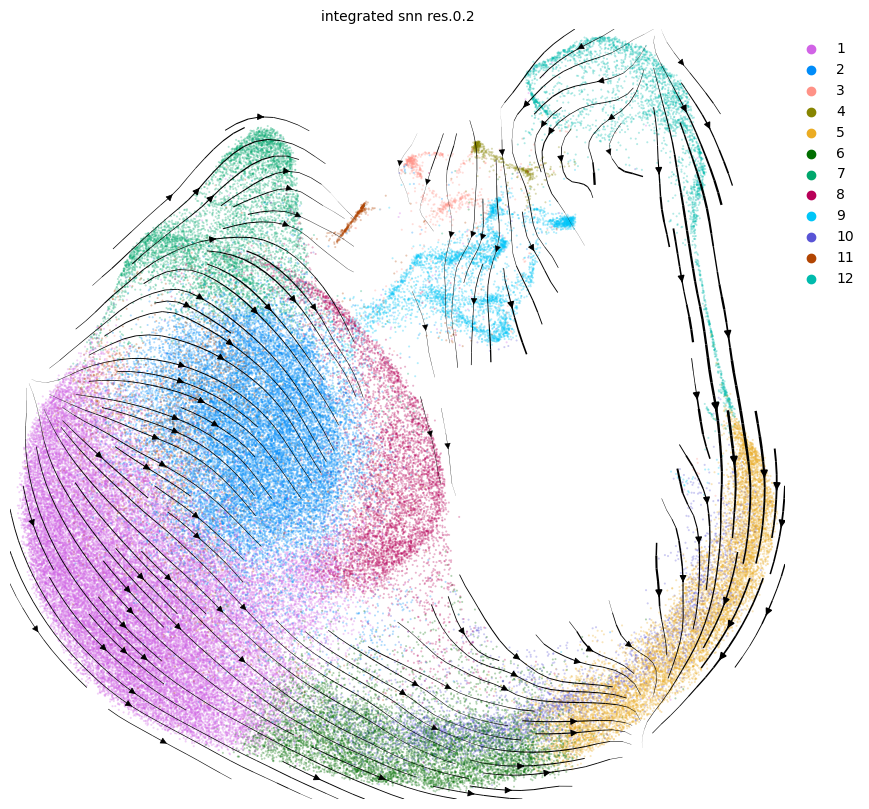

In [5]:
scv.pl.velocity_embedding_stream(neumap_dynamical, basis="umap", palette=neutrophils_color_palette, figsize=(10,10),
                                 color="integrated_snn_res.0.2",legend_loc="upper right", 
                                 save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_stream.png")

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_arrows.png


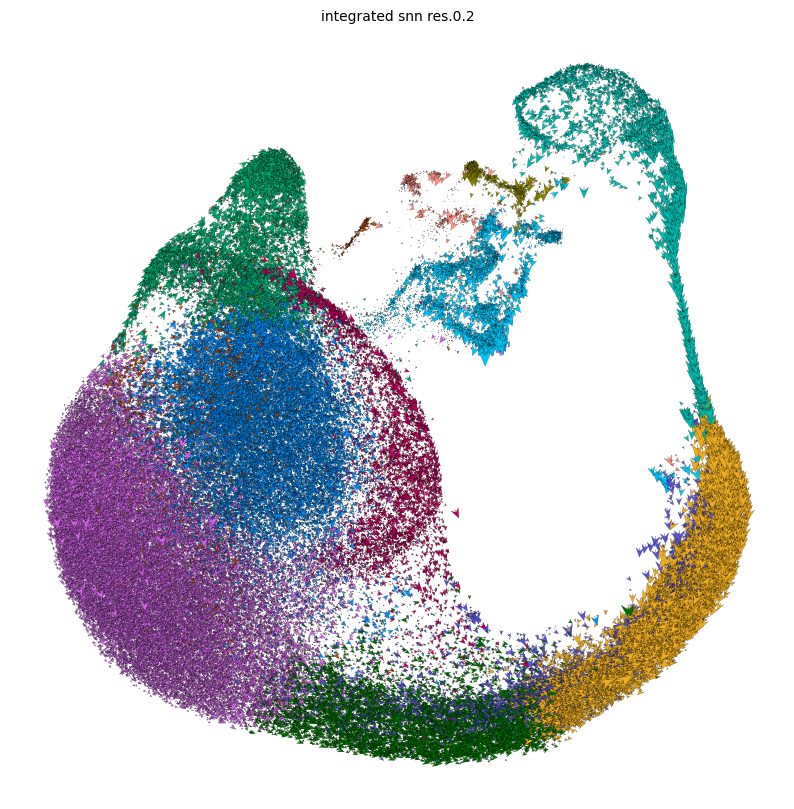

In [9]:
scv.pl.velocity_embedding(neumap_dynamical, basis="umap", arrow_length=10, arrow_size=10, palette=neutrophils_color_palette, 
                          color="integrated_snn_res.0.2",figsize=(10,10),
                          save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_arrows.png")

computing velocity embedding
    finished (0:00:46) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


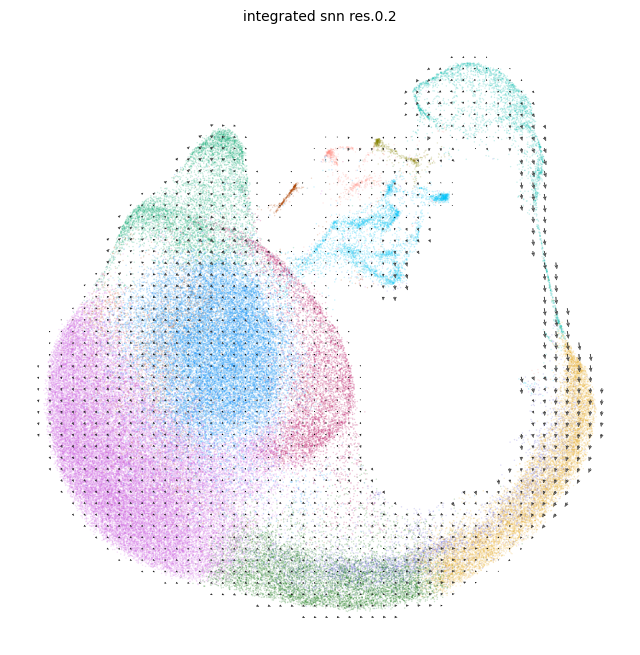

In [10]:
scv.pl.velocity_embedding_grid(neumap_dynamical, basis='umap', palette=neutrophils_color_palette, color="integrated_snn_res.0.2", figsize=(8,8))


#### 1.2.2. Velocity confidence

In [11]:
scv.tl.velocity_confidence(neumap_dynamical)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


In [12]:
np.mean(neumap_dynamical.obs["velocity_confidence"])

0.9092944185024172

In [13]:
np.median(neumap_dynamical.obs["velocity_confidence"])

0.9259320757728075

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_confidence_velocyto.png


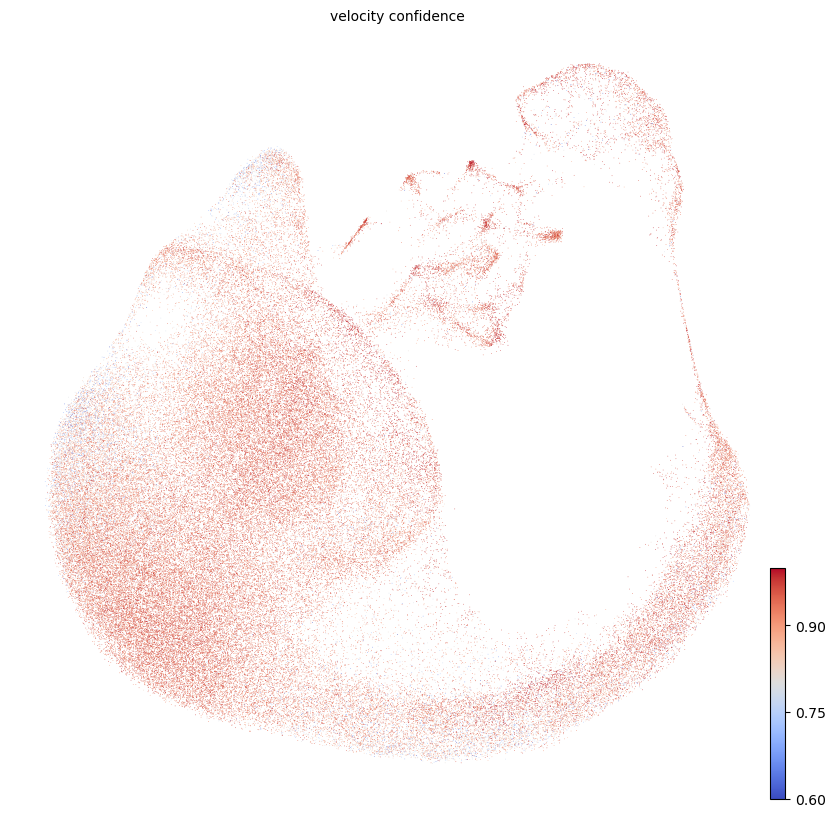

In [14]:
scv.pl.scatter(neumap_dynamical, c='velocity_confidence', cmap='coolwarm', vmin=0.6, vmax=1,figsize=(10,10),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_confidence_velocyto.png")

#### 1.2.3. Latent time

In [5]:
scv.tl.latent_time(neumap_dynamical)

computing latent time using root_cells as prior
    finished (0:01:03) --> added 
    'latent_time', shared time (adata.obs)


saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_pseudotime.png


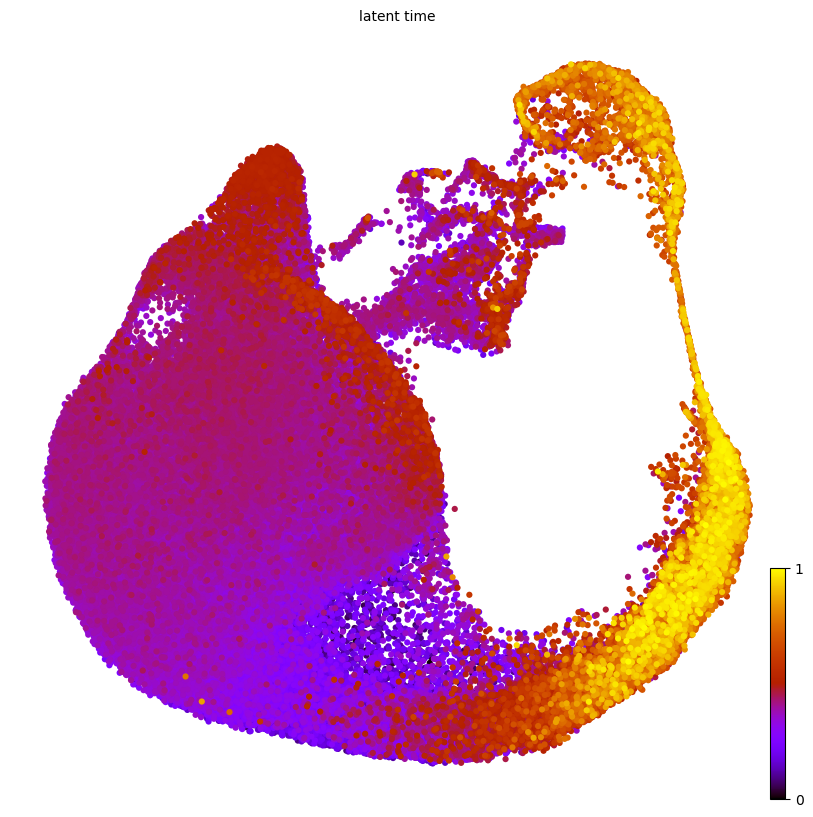

In [6]:
scv.pl.scatter(neumap_dynamical, basis="umap", color='latent_time', cmap='gnuplot', size=80, figsize=(10,10),
              save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_pseudotime.png")

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_pseudotime_heatmap.png


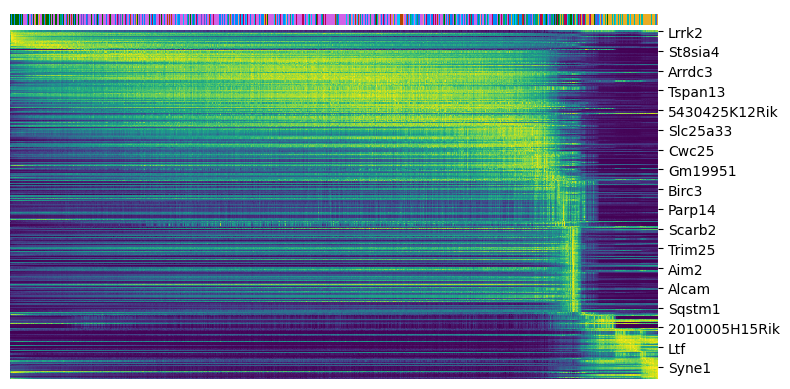

In [7]:
top_genes = neumap_dynamical.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(neumap_dynamical, var_names=top_genes, sortby='latent_time', col_color='integrated_snn_res.0.2', n_convolve=100,
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_pseudotime_heatmap.png")

#### 1.2.4. Root cells and endpoints

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_root_end.png


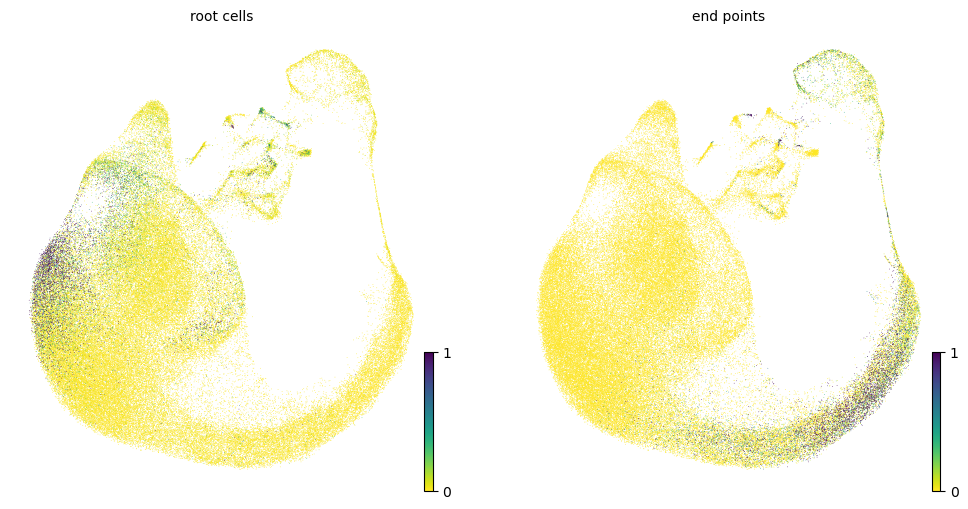

In [8]:
scv.pl.scatter(neumap_dynamical, color=['root_cells', 'end_points'],figsize=(6,6),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_dynamical_root_end.png")

#### 1.2.5. Top-likelihood genes

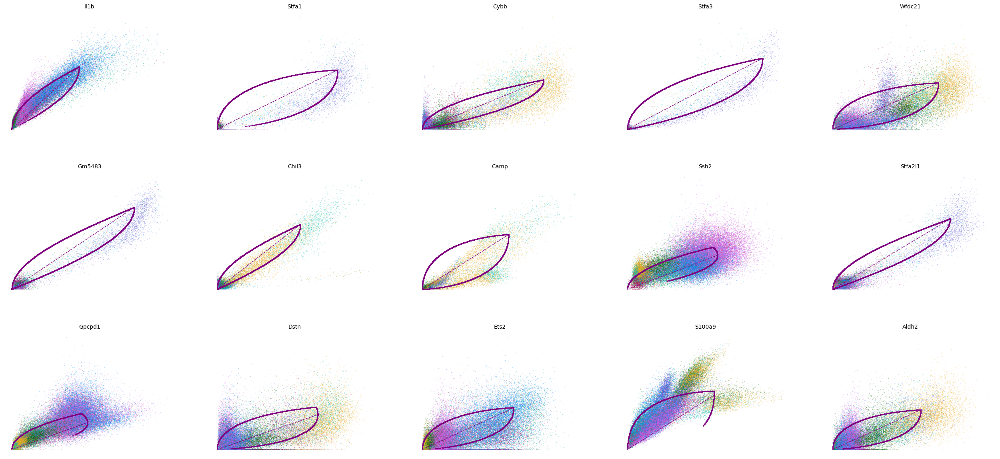

In [9]:
top_genes = neumap_dynamical.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(neumap_dynamical, basis=top_genes[:15], ncols=5, frameon=False, color="integrated_snn_res.0.2")

#### 1.2.6. Cluster-specific top-likelihood genes

In [10]:
scv.tl.rank_dynamical_genes(neumap_dynamical, groupby='integrated_snn_res.0.2')
df = scv.get_df(neumap_dynamical, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:01:04) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,1,2,3,4,5,6,7,8,9,10,11,12
0,S100a9,Il1b,Il1b,2010005H15Rik,Cybb,Ssh2,Gpcpd1,Il1b,Il1b,Stfa1,Il1b,Wfdc21
1,Gpcpd1,Actb,S100a9,Stfa2,Camp,Wfdc21,Actb,Ets2,S100a9,Stfa3,S100a9,Cybb
2,Fbxl5,S100a9,Gpcpd1,Stfa3,Wfdc21,Lcn2,Tmcc1,S100a9,Gpcpd1,Ngp,Actb,Aoah
3,Entpd1,Tmcc1,Actb,Stfa2l1,Tmcc1,Fbxl5,Ssh2,Actb,Fbxl5,Gm5416,Gpcpd1,Cenpf
4,Actb,Ets2,Fbxl5,Stfa1,Cd177,Dhrs9,Ets2,Gpcpd1,Actb,Dhrs9,Fbxl5,Cd177


### 1.3. Deterministic model

In [6]:
neumap_deterministic = Vel_SeurObj_no_mutants.copy()

#### 1.3.1. Analysis

In [7]:
# Standard scvelo processing 
scv.pp.filter_and_normalize(neumap_deterministic, min_shared_counts=30, n_top_genes=2000)
scv.pp.moments(neumap_deterministic, n_pcs=30, n_neighbors=50)

Filtered out 21524 genes that are detected 30 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
computing neighbors
    finished (0:00:52) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:16) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [8]:
scv.tl.velocity(neumap_deterministic, mode='deterministic')
scv.tl.velocity_graph(neumap_deterministic)

computing velocities
    finished (0:00:11) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/4 cores)


  0%|          | 0/109446 [00:00<?, ?cells/s]

    finished (0:07:39) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [9]:
neumap_deterministic.write_h5ad("./data/deterministic_model_neighbors_50.h5ad")

In [3]:
neumap_deterministic = scv.read("./data/deterministic_model_neighbors_50.h5ad")
neumap_deterministic

AnnData object with n_obs × n_vars = 109446 × 2000
    obs: 'CHIP', 'Cell_Index', 'Sample_Name', 'Sample_Tag', 'celltype', 'celltype_cell', 'condition', 'dataset', 'experiment', 'experiment_mine', 'integrated_snn_res.0.2', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'orig.names', 'tissue', 'batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'neighbors', 'pca', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced', 'velocity'
    obsp: 'connectivities', 'distances'

computing velocity embedding
    finished (0:00:44) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_stream.png


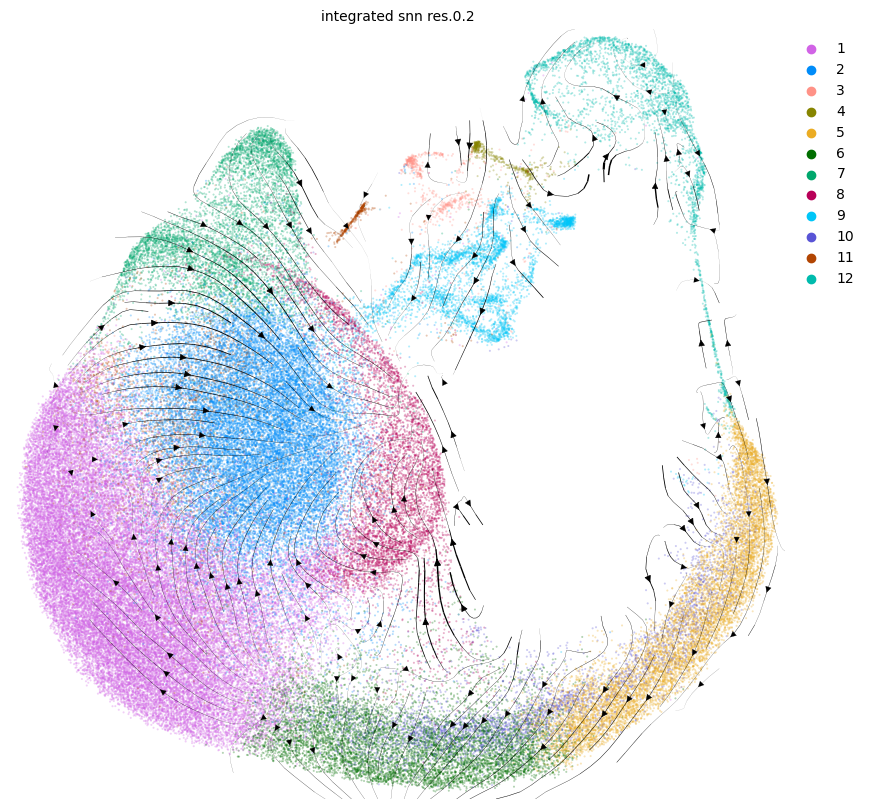

In [5]:
scv.pl.velocity_embedding_stream(neumap_deterministic, basis="umap", palette=neutrophils_color_palette, figsize=(10,10),
                                 color="integrated_snn_res.0.2",legend_loc="upper right", 
                                 save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_stream.png")

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_arrows.png


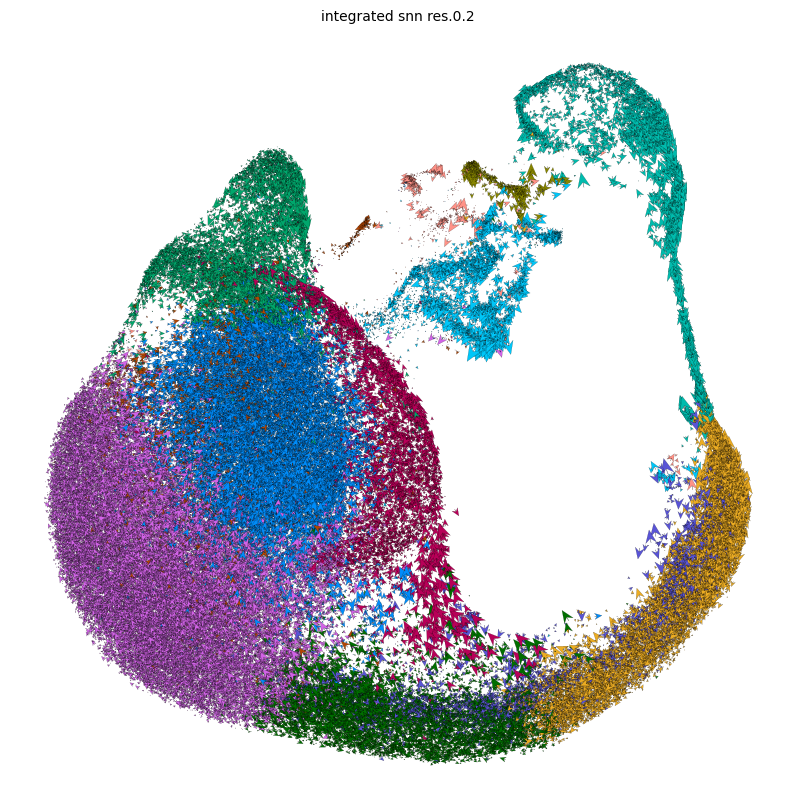

In [9]:
scv.pl.velocity_embedding(neumap_deterministic, basis="umap", arrow_length=10, arrow_size=10,
                          color="integrated_snn_res.0.2", figsize=(10,10), palette=neutrophils_color_palette,
                          save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_arrows.png")

computing velocity embedding
    finished (0:00:41) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


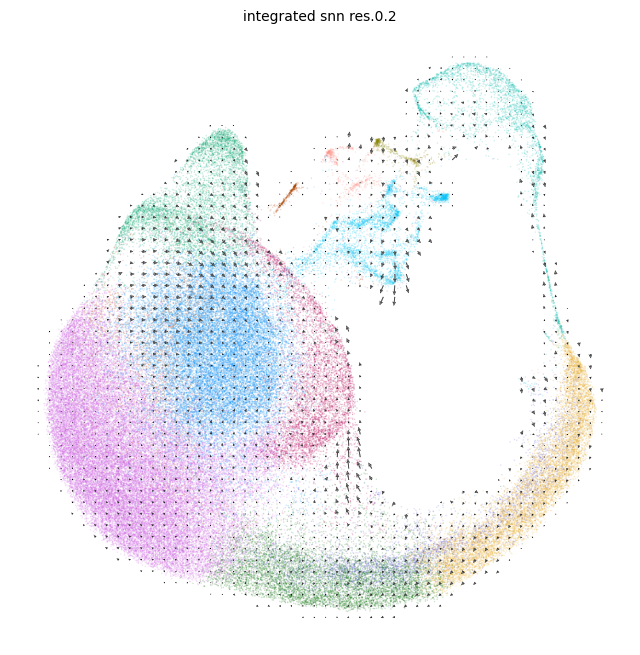

In [10]:
scv.pl.velocity_embedding_grid(neumap_deterministic, basis='umap', palette=neutrophils_color_palette, color="integrated_snn_res.0.2", figsize=(8,8))


#### 1.3.2. Velocity confidence

In [5]:
scv.tl.velocity_confidence(neumap_deterministic)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


In [6]:
np.mean(neumap_deterministic.obs["velocity_confidence"])

0.7846444635407019

In [7]:
np.median(neumap_deterministic.obs["velocity_confidence"])

0.7997384071350098

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_confidence.png


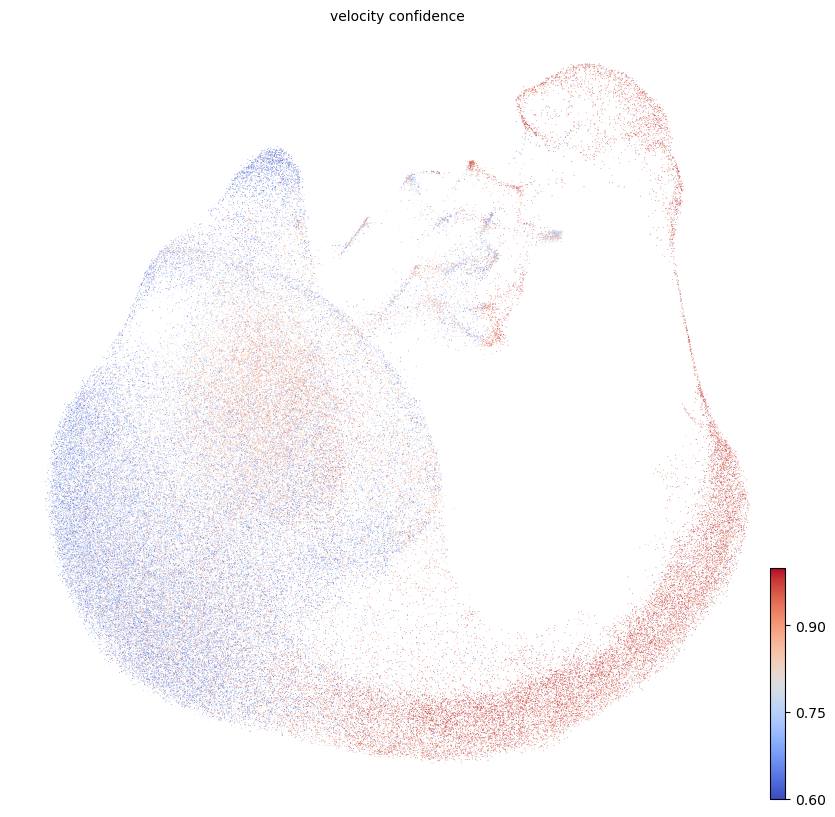

In [8]:
scv.pl.scatter(neumap_deterministic, c="velocity_confidence", cmap="coolwarm", vmin=0.6, vmax=1,figsize=(10,10),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_confidence.png")

#### 1.3.3. Velocity pseudotime (comparable to latent time)

In [9]:
scv.tl.velocity_pseudotime(neumap_deterministic)

computing terminal states
    identified 7 regions of root cells and 1 region of end points .
    finished (0:01:43) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_pseudotime.png


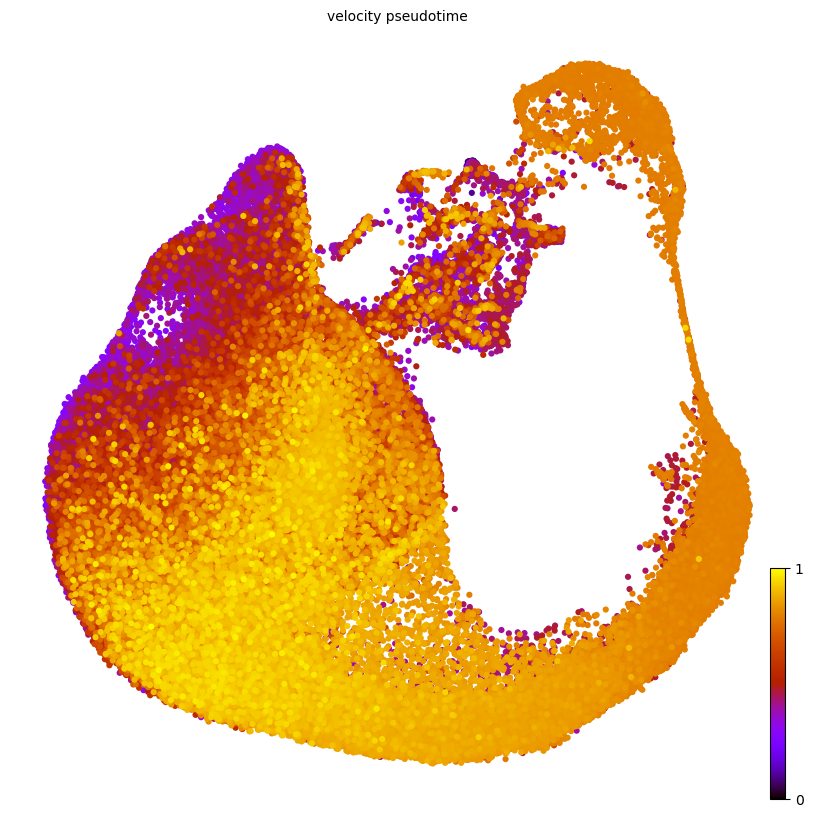

In [10]:
scv.pl.scatter(neumap_deterministic, basis="umap", color='velocity_pseudotime', color_map='gnuplot', size=80, figsize=(10,10),
              save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_pseudotime.png")

In [11]:
scv.tl.rank_velocity_genes(neumap_deterministic, groupby='integrated_snn_res.0.2')

ranking velocity genes
    finished (0:00:53) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_pseudotime_heatmap.png


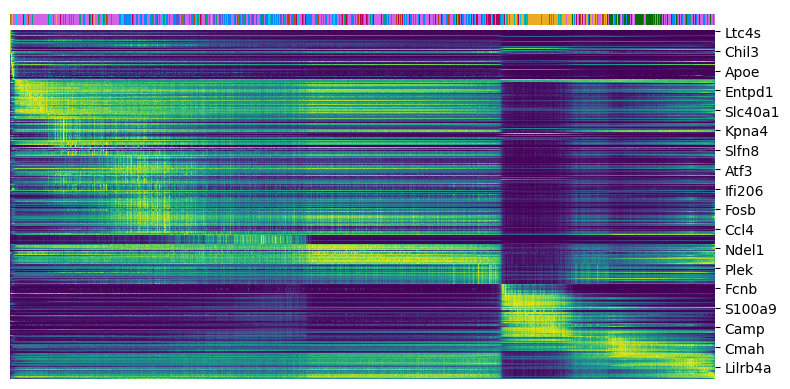

In [12]:
top_genes = neumap_deterministic.var['spearmans_score'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(neumap_deterministic, var_names=top_genes, sortby='velocity_pseudotime', col_color='integrated_snn_res.0.2', n_convolve=100,
              save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_pseudotime_heatmap.png")

#### 1.3.4. Root cells and endpoints

saving figure to file ./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_root_end.png


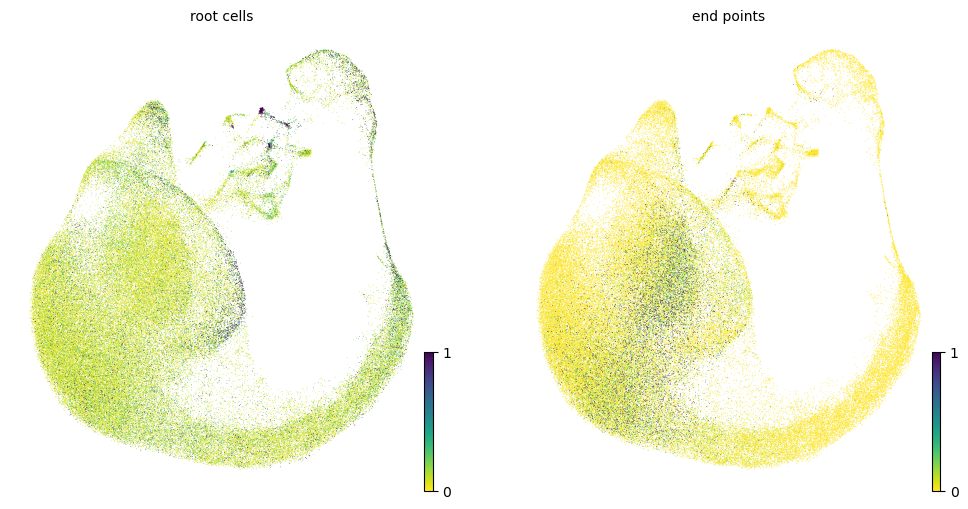

In [13]:
scv.pl.scatter(neumap_deterministic, color=["root_cells", "end_points"], figsize=(6,6),
               save="./Results/Plots/velocyto_and_scvelo_plots/neutrophils_deterministic_root_end.png")

#### 1.3.5. Top-spearmans_score genes

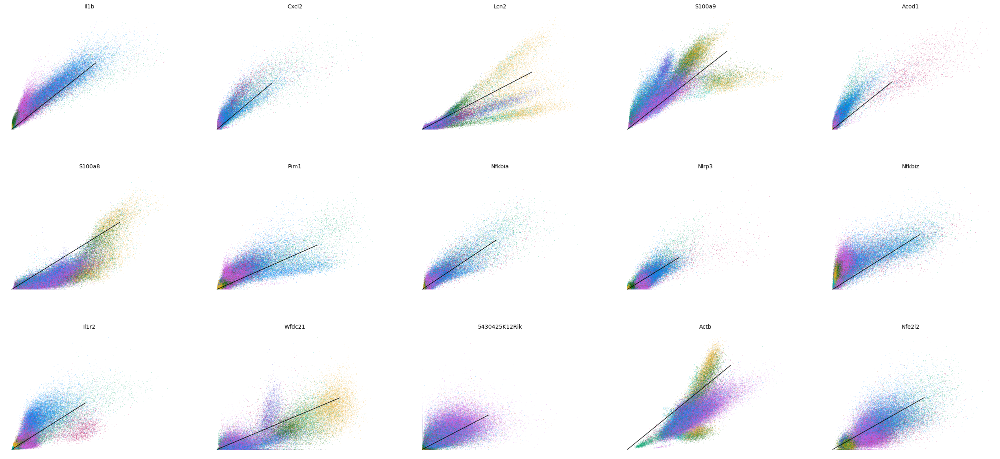

In [14]:
top_genes = neumap_deterministic.var['spearmans_score'].sort_values(ascending=False).index
scv.pl.scatter(neumap_deterministic, basis=top_genes[:15], ncols=5, frameon=False, color="integrated_snn_res.0.2")

#### 1.3.6. Cluster-specific top-spearmans_score genes

In [15]:
df = scv.get_df(neumap_deterministic, 'rank_velocity_genes/names')
df.head(5)

,1,2,3,4,5,6,7,8,9,10,11,12
0,Il1b,Il1r2,Dhrs9,Ruvbl2,S100a6,S100a6,Plek,Dach1,Dhrs9,S100a9,Clec4e,Cd177
1,Lcn2,Smox,Ifi209,Ccl6,Fbxl5,Ccl6,Acod1,Irak2,Nr4a2,Fbxl5,Dhrs9,Syne1
2,Dstn,Samsn1,Ifi213,AU020206,Cd177,Ccnl1,Nlrp3,Cd274,Ifi213,Wfdc21,Smox,Ruvbl2
3,Camp,Acod1,Gpihbp1,Apoe,Tnf,Fbxl5,4930430E12Rik,Dock10,4930430E12Rik,Cd177,Il1r2,Noct
4,Lgals3,Tgm2,Smc2,Nr4a2,Ccnl1,Ets2,Anxa1,Fmnl2,Ifi207,Sik1,Rabgef1,Tnf
